based on ur_robot_v3.ipynb and franka_robot_v2.ipynb


# Franka

## library

In [4]:
import os
import numpy as np
import pandas as pd

import chart_studio.plotly as py
import plotly.graph_objs as go
from plotly.offline import iplot, init_notebook_mode
# Using plotly + cufflinks in offline mode
import cufflinks
import matplotlib.pyplot as plt
import seaborn as sns
cufflinks.go_offline(connected=True)
init_notebook_mode(connected=True)

class make_folder_dataset:
    def __init__(self, folder_path:str, save_path) -> None:
        self.path = folder_path
        self.save_path = save_path
        self.num_lines_per_message = 130
        self.df = pd.DataFrame()
        self.df_dataset = pd.DataFrame()
        self.tau = ['tau_J0','tau_J1', 'tau_J2', 'tau_J3', 'tau_J4', 'tau_J5', 'tau_J6']
        self.tau_d = ['tau_J_d0','tau_J_d1', 'tau_J_d2', 'tau_J_d3', 'tau_J_d4', 'tau_J_d5', 'tau_J_d6']
        self.tau_ext =['tau_ext0','tau_ext1','tau_ext2','tau_ext3','tau_ext4','tau_ext5','tau_ext6']

        self.q = ['q0','q1','q2','q3','q4','q5','q6']
        self.q_d = ['q_d0','q_d1','q_d2','q_d3','q_d4','q_d5','q_d6']

        self.dq = ['dq0','dq1','dq2','dq3','dq4','dq5','dq6']
        self.dq_d = ['dq_d0','dq_d1','dq_d2','dq_d3','dq_d4','dq_d5','dq_d6']


        self.e = ['e0','e1','e2','e3','e4','e5','e6']
        self.de = ['de0','de1','de2','de3','de4','de5','de6']
        self.etau = ['etau_J0','etau_J1', 'etau_J2', 'etau_J3', 'etau_J4', 'etau_J5', 'etau_J6']
    
    def _extract_array(self, data_dict:dict, data_frame:str, header:list,  n:int):
            dof = 7
            x, y = data_frame[n].split(':')
            y = y.replace('[','')
            y = y.replace(']','')
            y = y.replace('\n','')

            y = y.split(',')
            for i in range(dof):
                data_dict[header[i]].append(float(y[i]))

    def extract_robot_data(self, ignore_get_label=False):
        # it extracts robot data from all_data.txt
        f = open(self.path + 'all_data.txt', 'r')
        lines = f.readlines()

        keywords = ['time'] + self.tau + self.tau_d + self.tau_ext + self.q + self.q_d + self.dq + self.dq_d 

        data_dict = dict.fromkeys(keywords)
        for i in keywords:
            data_dict[i]=[0]
        
        for i in range(int(len(lines)/self.num_lines_per_message)):
            data_frame = lines[i*self.num_lines_per_message:(i+1)*self.num_lines_per_message]
            
            x, y = data_frame[3].split(':')
            time_ = int(y)-int(int(y)/1000000)*1000000

            x, y = data_frame[4].split(':')
            time_ = time_+int(y)/np.power(10,9)

            data_dict['time'].append(time_)
            
            self._extract_array(data_dict,data_frame,self.tau, 25)
            self._extract_array(data_dict,data_frame,self.tau_d, 26)
            self._extract_array(data_dict,data_frame, self.tau_ext, 37)
            
            self._extract_array(data_dict,data_frame,self.q, 28)
            
            self._extract_array(data_dict,data_frame, self.q_d, 29)
            self._extract_array(data_dict,data_frame, self.dq, 30)
            self._extract_array(data_dict,data_frame, self.dq_d, 31)
        
       
        self.df = pd.DataFrame.from_dict(data_dict)
        self.df = self.df.drop(index=0).reset_index()
        
        for i in range(len(self.e)):
            self.df[self.e[i]] = self.df[self.q_d[i]]-self.df[self.q[i]]
        for i in range(len(self.de)):
            self.df[self.de[i]] = self.df[self.dq_d[i]]-self.df[self.dq[i]]
        for i in range(len(self.etau)):
            self.df[self.etau[i]] = self.df[self.tau_d[i]]-self.df[self.tau[i]]
        self.ros_time = self.df['time'][0]
        self.df.time = self.df.time-self.df.time[0]
        if not ignore_get_label:
            self.get_labels(self.df)
            self.df.to_csv(self.save_path + 'labeled_data.csv', index=False)
            #self.df.to_csv(self.save_path +'robot_data.csv',index=False)

    def get_labels(self, df):
        # it syncronize true labeled (contact- noncontact) data with robot data
        true_label = pd.read_csv(self.path+'true_label.csv')
        true_label['time'] = true_label['time_sec']+true_label['time_nsec']-self.ros_time
        time_dev = true_label['time'].diff()
        contact_events_index = np.append([0], true_label['time'][time_dev>0.05].index.values)
        contact_events_index = np.append(contact_events_index,  true_label['time'].shape[0]-1)
        
        contact_count = 0
        df['label']=0

        for i in range(df['time'].shape[0]):
            if (df['time'][i]-true_label['time'][contact_events_index[contact_count]]) > 0:
                #print(i ,',', contact_events_index[contact_count], ',',self.df['time'][i], '   ', true_label['time'][contact_events_index[contact_count]] )
                contact_count += 1
                if contact_count == len(contact_events_index):
                    break
                for j in range(i, df['time'].shape[0]):
                    df.loc[j, 'label'] = 1
                    #print(j)
                    if (df['time'][j] - true_label['time'][contact_events_index[contact_count]-1]) > 0:
                        #print(j ,',', contact_events_index[contact_count]-1, ',', self.df['time'][j], '   ', true_label['time'][contact_events_index[contact_count]-1] )
                        #print('----------------------------------------')
                        i = j
                        break
        
        return df

    def make_sequence(self):
        #window_time = 140ms
        seq_num = 28
        gap = 4
        selected_features= self.e + self.tau

        dataset = pd.DataFrame(np.ones((int((self.df.shape[0]-seq_num)/gap), seq_num*len(selected_features)+1))*2 )
        index = 0
        state = False
        last_contact_indexes = self.df.loc[self.df['label']==1,'index'].values
        last_contact_indexes = last_contact_indexes[last_contact_indexes.shape[0]-1]

        for i in range(0, last_contact_indexes, gap):
            if state: 
                window = self.df[selected_features][i:i+seq_num]
                dataset.iloc[index,0] = self.df['label'][i+seq_num]
                dataset.iloc[index, 1:len(dataset.columns)] = np.hstack(window.to_numpy())
                index += 1
            else:
                if self.df['label'][i+seq_num] == 1:
                    state = 1
        self.dataset = dataset.drop(index=dataset.loc[dataset[0]==2,0].index)

        name = self.path.split('/')[len(self.path.split('/'))-2]+'.csv'
        self.dataset.to_csv(self.save_path+name, index=False)
        return self.dataset
    
    def split_data(self, train_split_rate = 0.75):
        msk = np.random.rand(len(self.dataset)) < train_split_rate
        train = self.dataset.loc[msk, :]
        test = self.dataset.loc[~msk, :]
        name = self.path.split('/')[len(self.path.split('/'))-2]+'_train.csv'
        train.to_csv(self.save_path+name, index=False)

        name = self.path.split('/')[len(self.path.split('/'))-2]+'_test.csv'
        test.to_csv(self.save_path+name, index=False)
def exteact_dfs(folder_path,save_data_file):
    print(folder_path)
    data = make_folder_dataset(folder_path,save_data_file)
    data.extract_robot_data()
    #data.df.iplot(x='time', y=['label'])

    robot_dof = 7
    num_features = 4*robot_dof
    time_seq = 28
    num_columns = time_seq * num_features 

    header = ['Time_sec', 'Time_nsec', 'prediction_duration', 'contact_out', 'collision_out', 'localization_out'] + [f'val_{i}' for i in range(num_columns)]

    df_model_out= pd.read_csv(folder_path+'model_result.csv', names=header, skiprows=1 )
    df_model_out.head()
    df_model_out['time']=df_model_out.Time_sec+df_model_out.Time_nsec-data.ros_time

    df_model_out=data.get_labels(df_model_out)
    return data, df_model_out

## output

In [51]:



files_and_dirs = '2024_07_29_inmotion_link6/'

folder_path = '../frankaRobot/DATA/source_robot/' + files_and_dirs
save_data_file = '../frankaRobot/DATA/dataset/'+ files_and_dirs
os.makedirs(save_data_file, exist_ok=True)    
data_source_robot, model_out_source_robot = exteact_dfs(folder_path, save_data_file)

scale = 30
data_source_robot.df['scaled_label']=data_source_robot.df['label']*scale
data_source_robot.df.iplot(x='time', y=data_source_robot.tau+['scaled_label'])
model_out_source_robot.iplot(x='time', y=['contact_out','label'])

files_and_dirs = '2024_08_08_link6_collaborative/'

folder_path = '../frankaRobot/DATA/target_robot/k_1/' + files_and_dirs
save_data_file = '../frankaRobot/DATA/dataset/'+ files_and_dirs
os.makedirs(save_data_file, exist_ok=True)    

data_target_robot, model_out_target_robot = exteact_dfs(folder_path,save_data_file)

scale = 30
data_target_robot.df['scaled_label']=data_target_robot.df['label']*scale
data_target_robot.df.iplot(x='time', y=data_target_robot.tau+['scaled_label'])
model_out_target_robot.iplot(x='time', y=['contact_out','label'])

../frankaRobot/DATA/source_robot/2024_07_29_inmotion_link6/


../frankaRobot/DATA/target_robot/k_1/2024_08_08_link6_collaborative/


In [55]:
scale = 0.002
data_ur10.df['scaled_label']=data_ur10.df['label']*scale
data_ur10.df.iplot(x='time', y=data_source_robot.e+['scaled_label'])

data_target_robot.df['scaled_label']=data_target_robot.df['label']*scale
data_target_robot.df.iplot(x='time', y=data_target_robot.e+['scaled_label'])

In [56]:
import plotly.graph_objs as go

# Create traces for the first dataset
traces = []
for column in data_target_robot.e:
    traces.append(go.Scatter(x=data_target_robot.df['time'], y=data_target_robot.df[column], mode='lines', name=column))

# Add the scaled_label trace
traces.append(go.Scatter(x=data_target_robot.df['time'], y=data_target_robot.df['scaled_label'], mode='lines', name='scaled_label'))

# Example: Add another plot from model_out_target_robot (e.g., 'scaled_contact_out')
traces.append(go.Scatter(x=model_out_target_robot['time'], y=model_out_target_robot['scaled_contact_out'], mode='lines', name='scaled_contact_out'))

# Create the layout
layout = go.Layout(
    title='Combined Plot',
    xaxis=dict(title='Time'),
    yaxis=dict(title='Values'),
    showlegend=True
)

# Create the figure and plot it
fig = go.Figure(data=traces, layout=layout)
fig.show()


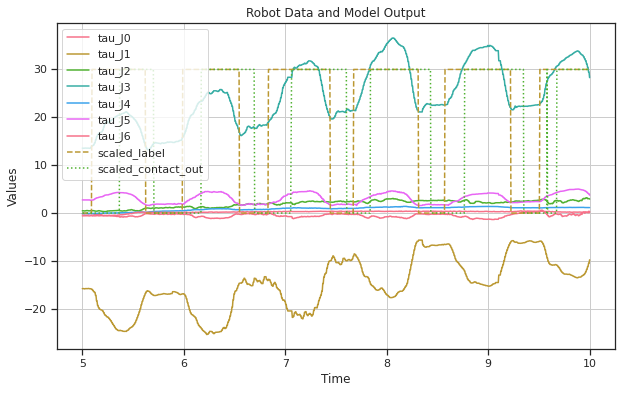

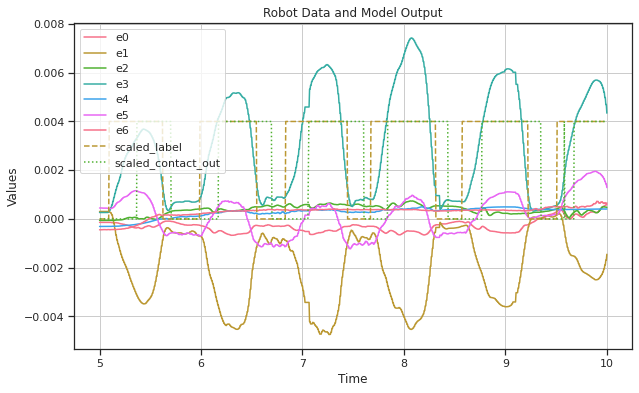

In [54]:
# Drop rows where 'time' is less than 5 or greater than 10 in data_source_robot.df
data_source_robot.df.drop(data_source_robot.df[(data_source_robot.df.time < 5) | (data_source_robot.df.time > 10)].index, inplace=True)

# Drop rows where 'time' is less than 5 or greater than 10 in model_out_source_robot
model_out_source_robot.drop(model_out_source_robot[(model_out_source_robot.time < 5) | (model_out_source_robot.time > 10)].index, inplace=True)

# Scale the labels
scale = 30
data_source_robot.df['scaled_label'] = data_source_robot.df['label'] * scale
model_out_source_robot['scaled_contact_out']=model_out_source_robot['contact_out'] * scale
# Plotting both datasets on the same plot
plt.figure(figsize=(10, 6))

# Plot scaled label and tau values from data_source_robot
for tau_column in data_source_robot.tau:
    plt.plot(data_source_robot.df['time'], data_source_robot.df[tau_column], label=tau_column)
plt.plot(data_source_robot.df['time'], data_source_robot.df['scaled_label'], label='scaled_label', linestyle='--')

# Plot contact_out and label from model_out_source_robot
plt.plot(model_out_source_robot['time'], model_out_source_robot['scaled_contact_out'], label='scaled_contact_out', linestyle=':')


# Customize the plot
plt.xlabel('Time')
plt.ylabel('Values')
plt.title('Robot Data and Model Output')
plt.legend()
plt.grid(True)

# Show the plot
plt.show()

# Scale the labels
scale = 0.004
data_source_robot.df['scaled_label'] = data_source_robot.df['label'] * scale
model_out_source_robot['scaled_contact_out']=model_out_source_robot['contact_out'] * scale
# Plotting both datasets on the same plot
plt.figure(figsize=(10, 6))

# Plot scaled label and tau values from data_source_robot
for tau_column in data_source_robot.e:
    plt.plot(data_source_robot.df['time'], data_source_robot.df[tau_column], label=tau_column)
plt.plot(data_source_robot.df['time'], data_source_robot.df['scaled_label'], label='scaled_label', linestyle='--')

# Plot contact_out and label from model_out_source_robot
plt.plot(model_out_source_robot['time'], model_out_source_robot['scaled_contact_out'], label='scaled_contact_out', linestyle=':')


# Customize the plot
plt.xlabel('Time')
plt.ylabel('Values')
plt.title('Robot Data and Model Output')
plt.legend()
plt.grid(True)

# Show the plot

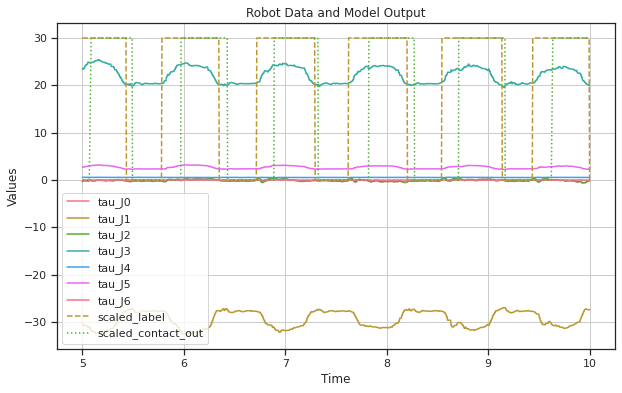

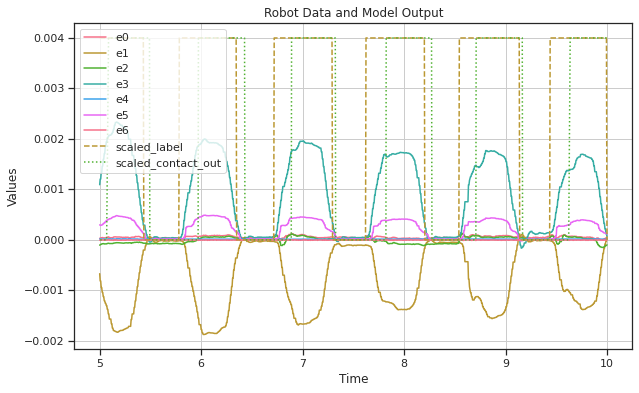

In [52]:
# Drop rows where 'time' is less than 5 or greater than 10 in data_target_robot.df
data_target_robot.df.drop(data_target_robot.df[(data_target_robot.df.time < 5) | (data_target_robot.df.time > 10)].index, inplace=True)

# Drop rows where 'time' is less than 5 or greater than 10 in model_out_target_robot
model_out_target_robot.drop(model_out_target_robot[(model_out_target_robot.time < 5) | (model_out_target_robot.time > 10)].index, inplace=True)

# Scale the labels
scale = 30
data_target_robot.df['scaled_label'] = data_target_robot.df['label'] * scale
model_out_target_robot['scaled_contact_out'] = model_out_target_robot['contact_out'] * scale

# Plotting both datasets on the same plot
plt.figure(figsize=(10, 6))

# Plot scaled label and tau values from data_target_robot
for tau_column in data_target_robot.tau:
    plt.plot(data_target_robot.df['time'], data_target_robot.df[tau_column], label=tau_column)
plt.plot(data_target_robot.df['time'], data_target_robot.df['scaled_label'], label='scaled_label', linestyle='--')

# Plot contact_out and label from model_out_target_robot
plt.plot(model_out_target_robot['time'], model_out_target_robot['scaled_contact_out'], label='scaled_contact_out', linestyle=':')

# Customize the plot
plt.xlabel('Time')
plt.ylabel('Values')
plt.title('Robot Data and Model Output')
plt.legend()
plt.grid(True)

# Show the plot
plt.show()

# Scale the labels
scale = 0.004
data_target_robot.df['scaled_label'] = data_target_robot.df['label'] * scale
model_out_target_robot['scaled_contact_out'] = model_out_target_robot['contact_out'] * scale

# Plotting both datasets on the same plot
plt.figure(figsize=(10, 6))

# Plot scaled label and tau values from data_target_robot
for tau_column in data_target_robot.e:
    plt.plot(data_target_robot.df['time'], data_target_robot.df[tau_column], label=tau_column)
plt.plot(data_target_robot.df['time'], data_target_robot.df['scaled_label'], label='scaled_label', linestyle='--')

# Plot contact_out and label from model_out_target_robot
plt.plot(model_out_target_robot['time'], model_out_target_robot['scaled_contact_out'], label='scaled_contact_out', linestyle=':')

# Customize the plot
plt.xlabel('Time')
plt.ylabel('Values')
plt.title('Robot Data and Model Output')
plt.legend()
plt.grid(True)

# Show the plot
plt.show()


# UR robots

In [1]:
import numpy as np
import pandas as pd
import os 
import chart_studio.plotly as py
import plotly.graph_objs as go
from plotly.offline import iplot, init_notebook_mode
# Using plotly + cufflinks in offline mode
import cufflinks
import matplotlib.pyplot as plt
import seaborn as sns

cufflinks.go_offline(connected=True)
init_notebook_mode(connected=True)

class make_folder_dataset:
    def __init__(self, directory_robot_data:str,directory_label_data:str, save_path:str, dof=6) -> None:
        self.directory_robot_data = directory_robot_data
        self.directory_label_data = directory_label_data
        self.save_path = save_path
        self.dof = dof
        os.makedirs(self.save_path, exist_ok=True)

        self.df = pd.DataFrame()
        self.df_dataset = pd.DataFrame()
        self._create_dummy_data(self.dof)

    def _create_dummy_data(self,dof):
        self.target_q = [f'target_q_{i}' for i in range(dof)]
        self.actual_q = [f'actual_q_{i}' for i in range(dof)]

        self.target_qd = [f'target_qd_{i}' for i in range(dof)]
        self.actual_qd = [f'actual_qd_{i}' for i in range(dof)]

        self.target_current = [f'target_current_{i}' for i in range(dof)]
        self.actual_current = [f'actual_current_{i}' for i in range(dof)]

        self.actual_TCP_pose = [f'actual_TCP_pose_{i}' for i in range(dof)]
        self.target_TCP_pose = [f'target_TCP_pose_{i}' for i in range(dof)]

        self.actual_TCP_speed = [f'actual_TCP_speed_{i}' for i in range(dof)]
        self.target_TCP_speed = [f'target_TCP_speed_{i}' for i in range(dof)]

        self.actual_TCP_force = [f'actual_TCP_force_{i}' for i in range(dof)]
        self.joint_control_output = [f'joint_control_output_{i}' for i in range(dof)]
        self.target_moment = [f'target_moment_{i}' for i in range(dof)]

        self.joint_temperatures = [f'joint_temperatures_{i}' for i in range(dof)]
        self.actual_execution_time = ['actual_execution_time']
        self.joint_mode = [f'joint_mode_{i}' for i in range(dof)]
        self.actual_tool_accelerometer = [f'actual_tool_accelerometer_{i}' for i in range(3)]
        
        self.actual_joint_voltage = [f'actual_joint_voltage_{i}' for i in range(dof)]

        self.e = [f'e{i}' for i in range(dof)]
        self.de = [f'de{i}' for i in range(dof)]
        self.etau = [f'etau{i}' for i in range(dof)]
        self.tau_ext = [f'tau_ext{i}' for i in range(dof)]
        self.e_i = [f'e_i{i}' for i in range(dof)]

    def extract_robot_data(self,k):
        
        df = pd.read_csv(self.directory_robot_data)

        # Extract the filename from the path
        file_name = os.path.basename(self.directory_robot_data)
        
        # Remove the file extension
        file_base = os.path.splitext(file_name)[0]

        # Convert the remaining string to a float
        self.ros_time = float(file_base)
        
        
        #k= [1.35,  1.361, 1.355, 0.957, 0.865, 0.893]    
        for i in range(self.dof):
            df[self.e_i[i]]= df[self.target_current[i]]-df[self.actual_current[i]]
            df[self.etau[i]]= df[self.e_i[i]]*k[i]
            df[self.e[i]] = df[self.target_q[i]]-df[self.actual_q[i]]
            df[self.de[i]] = df[self.target_qd[i]]-df[self.actual_qd[i]]
        
        df.rename(columns={'timestamp':'time'}, inplace=True)
        df['time']=df['time']-df['time'][0]
        #self.df.to_csv(self.save_path +'robot_data.csv',index=False)
        self.df = self.get_labels(df)
        self.df.to_csv(self.save_path+'/labeled_data.csv' , index=False)

    def get_labels(self,df):
        # it syncronize true labeled (contact- noncontact) data with robot data
        true_label = pd.read_csv(self.directory_label_data)
        large_prefix = str(self.ros_time)[:4]
        time0 = true_label.time_sec[0]+true_label.time_nsec[0]

        df_time0 = float(large_prefix+str(time0))
        dt_ros = df_time0-self.ros_time

        true_label['time']=true_label.time_sec+true_label.time_nsec-time0 + dt_ros

        self.true_label=true_label
        time_dev = true_label['time'].diff()
        contact_events_index = np.append([0], true_label['time'][time_dev>0.05].index.values)
        contact_events_index = np.append(contact_events_index,  true_label['time'].shape[0]-1)

        contact_count = 0
        df['label']=0

        for i in range(df['time'].shape[0]):
            if (df['time'][i]-true_label['time'][contact_events_index[contact_count]]) > 0:
                #print(i ,',', contact_events_index[contact_count], ',',df['time'][i], '   ', true_label['time'][contact_events_index[contact_count]] )
                contact_count += 1
                if contact_count == len(contact_events_index):
                    break
                for j in range(i, df['time'].shape[0]):
                    df.loc[j, 'label'] = 1
                    #print(j)
                    if (df['time'][j] - true_label['time'][contact_events_index[contact_count]-1]) > 0:
                        #print(j ,',', contact_events_index[contact_count]-1, ',', df['time'][j], '   ', true_label['time'][contact_events_index[contact_count]-1] )
                        #print('----------------------------------------')
                        i = j
                        break
        return df
        
        
    def make_sequence(self):
        #window_time = 140ms
        seq_num = 28
        gap = 4
        selected_features= self.e + self.tau

        dataset = pd.DataFrame(np.ones((int((self.df.shape[0]-seq_num)/gap), seq_num*len(selected_features)+1))*2 )
        index = 0
        state = False
        last_contact_indexes = self.df.loc[self.df['label']==1,'index'].values
        last_contact_indexes = last_contact_indexes[last_contact_indexes.shape[0]-1]

        for i in range(0, last_contact_indexes, gap):
            if state: 
                window = self.df[selected_features][i:i+seq_num]
                dataset.iloc[index,0] = self.df['label'][i+seq_num]
                dataset.iloc[index, 1:len(dataset.columns)] = np.hstack(window.to_numpy())
                index += 1
            else:
                if self.df['label'][i+seq_num] == 1:
                    state = 1
        self.dataset = dataset.drop(index=dataset.loc[dataset[0]==2,0].index)

        name = self.path.split('/')[len(self.path.split('/'))-2]+'.csv'
        self.dataset.to_csv(self.save_path+name, index=False)
        return self.dataset
    
    def split_data(self, train_split_rate = 0.75):
        msk = np.random.rand(len(self.dataset)) < train_split_rate
        train = self.dataset.loc[msk, :]
        test = self.dataset.loc[~msk, :]
        name = self.path.split('/')[len(self.path.split('/'))-2]+'_train.csv'
        train.to_csv(self.save_path+name, index=False)

        name = self.path.split('/')[len(self.path.split('/'))-2]+'_test.csv'
        test.to_csv(self.save_path+name, index=False)



In [10]:

def data_analysis(folder_name, robot_data_path, label_data_path, dataset_path,k):
    # Get a list of all files and directories in the specified directory
    folder_path = robot_data_path+folder_name
    files = os.listdir(folder_path)
    files = [f for f in files if os.path.isfile(os.path.join(folder_path, f))]
    robot_data_file = folder_path +'/'+ files[0]
    
    label_data_file = label_data_path + folder_name + '/true_label.csv'

    save_data_file = dataset_path + folder_name
    
    print(robot_data_file, label_data_file)
    
    data = make_folder_dataset(robot_data_file,label_data_file,save_data_file, 6)
    data.extract_robot_data(k)
    #data.df.iplot(x='time', y=['label'])
    targetA = data.actual_current
    targetB = data.target_current

    #data.df.iplot(x='time', y = targetA+ targetB+['label'], xTitle='time (sec)')
    df_model_out= pd.read_csv(label_data_path+folder_name+'/model_out.csv')
    df_model_out.head()

    large_prefix = str(data.ros_time)[:4]
    time0 = df_model_out.iloc[0,0]+df_model_out.iloc[0,1]

    df_time0 = float(large_prefix+str(time0))
    dt_ros = df_time0-data.ros_time

    df_model_out['time']=df_model_out.iloc[:,0]+df_model_out.iloc[:,1]-time0 + dt_ros
    df_model_out=data.get_labels(df_model_out)

    #df_model_out.iplot(x='time', y=[ 'label','contact_out'])
    #df_model_out.iplot(x='time', y='prediction_duration')
    
    df_model_out = df_model_out[:][df_model_out['time']>min(data.true_label.time)]
    df_model_out = df_model_out[:][df_model_out['time']<max(data.true_label.time)].reset_index()
    df_model_out.time = df_model_out.time - df_model_out.time[0]
    if folder_name == '2024_07_29_link5':
        df_model_out = df_model_out[:][df_model_out['time']>5].reset_index()
        df_model_out.time = df_model_out.time - df_model_out.time[0]

    return data, df_model_out

## UR10

In [18]:
data_path = '../urRobot/DATA/UR10/'
folder_name='2024_07_29_link4/'

# Specify the directory you want to list files for
robot_data_path = data_path+'robot_data/'
label_data_path = data_path+'model_out/'

dataset_path = data_path+'dataset'
os.makedirs(dataset_path, exist_ok=True)
k= [0.75, 0.73, 0.9, 0.89, 0.6, 0.65]
data_ur10,model_out_ur10= data_analysis(folder_name,robot_data_path, label_data_path, dataset_path,k)

../urRobot/DATA/UR10/robot_data/2024_07_29_link4//1722239003.855974.txt ../urRobot/DATA/UR10/model_out/2024_07_29_link4//true_label.csv


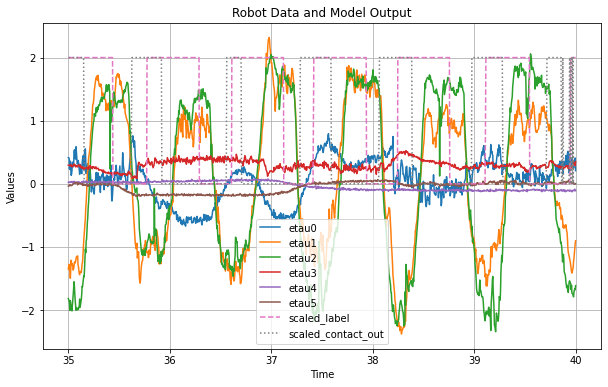

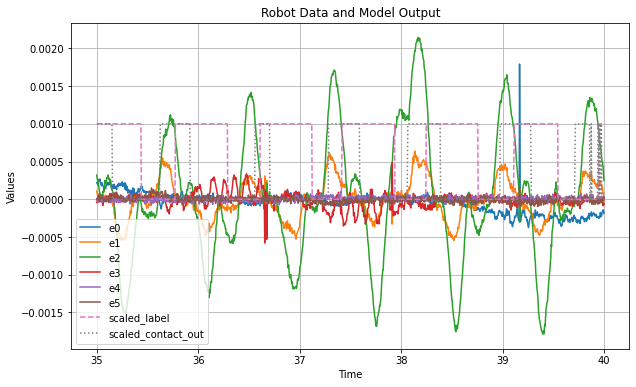

In [23]:
# Drop rows where 'time' is less than 5 or greater than 10 in data_source_robot.df
data_ur10.df.drop(data_ur10.df[(data_ur10.df.time < 35) | (data_ur10.df.time > 40)].index, inplace=True)

# Drop rows where 'time' is less than 5 or greater than 10 in model_out_source_robot
model_out_ur10.drop(model_out_ur10[(model_out_ur10.time < 35) | (model_out_ur10.time > 40)].index, inplace=True)

# Scale the labels
scale = 2
data_ur10.df['scaled_label'] = data_ur10.df['label'] * scale
model_out_ur10['scaled_contact_out']=model_out_ur10['contact_out'] * scale

# Plotting both datasets on the same plot
plt.figure(figsize=(10, 6))

# Plot scaled label and tau values from data_source_robot
for tau_column in data_ur10.etau:
    plt.plot(data_ur10.df['time'], data_ur10.df[tau_column], label=tau_column)
plt.plot(data_ur10.df['time'], data_ur10.df['scaled_label'], label='scaled_label', linestyle='--')

# Plot contact_out and label from model_out_source_robot
plt.plot(model_out_ur10['time'], model_out_ur10['scaled_contact_out'], label='scaled_contact_out', linestyle=':')


# Customize the plot
plt.xlabel('Time')
plt.ylabel('Values')
plt.title('Robot Data and Model Output')
plt.legend()
plt.grid(True)

# Show the plot
plt.show()

# Scale the labels
scale = 0.001
data_ur10.df['scaled_label'] = data_ur10.df['label'] * scale
model_out_ur10['scaled_contact_out']=model_out_ur10['contact_out'] * scale
# Plotting both datasets on the same plot
plt.figure(figsize=(10, 6))

# Plot scaled label and tau values from data_source_robot
for tau_column in data_ur10.e:
    plt.plot(data_ur10.df['time'], data_ur10.df[tau_column], label=tau_column)
plt.plot(data_ur10.df['time'], data_ur10.df['scaled_label'], label='scaled_label', linestyle='--')

# Plot contact_out and label from model_out_source_robot
plt.plot(model_out_ur10['time'], model_out_ur10['scaled_contact_out'], label='scaled_contact_out', linestyle=':')


# Customize the plot
plt.xlabel('Time')
plt.ylabel('Values')
plt.title('Robot Data and Model Output')
plt.legend()
plt.grid(True)

# Show the plot

In [29]:
import plotly.graph_objs as go
# Scale the labels
scale = 2
data_ur10.df['scaled_label'] = data_ur10.df['label'] * scale
model_out_ur10['scaled_contact_out']=model_out_ur10['contact_out'] * scale

# Create traces for the first dataset
traces = []
for column in data_ur10.etau:
    traces.append(go.Scatter(x=data_ur10.df['time'], y=data_ur10.df[column], mode='lines', name=column))

# Add the scaled_label trace
traces.append(go.Scatter(x=data_ur10.df['time'], y=data_ur10.df['scaled_label'], mode='lines', name='scaled_label'))

# Example: Add another plot from model_out_target_robot (e.g., 'scaled_contact_out')
traces.append(go.Scatter(x=model_out_ur10['time'], y=model_out_ur10['scaled_contact_out'], mode='lines', name='scaled_contact_out'))

# Create the layout
layout = go.Layout(
    title='Combined Plot',
    xaxis=dict(title='Time'),
    yaxis=dict(title='Values'),
    showlegend=True
)

# Create the figure and plot it
fig = go.Figure(data=traces, layout=layout)
fig.show()


## UR5

In [47]:
data_path = '../urRobot/DATA/'
folder_name='2024_07_02_link4/'

# Specify the directory you want to list files for
robot_data_path = data_path+'robot_data/'
label_data_path = data_path+'model_out/'

dataset_path = data_path+'dataset'
os.makedirs(dataset_path, exist_ok=True)
k = [1.35, 1.361, 1.355, 0.957, 0.865, 0.893]
data_ur5,model_out_ur5= data_analysis(folder_name,robot_data_path, label_data_path, dataset_path,k)

../urRobot/DATA/robot_data/2024_07_02_link4//1719935378.2136424.txt ../urRobot/DATA/model_out/2024_07_02_link4//true_label.csv


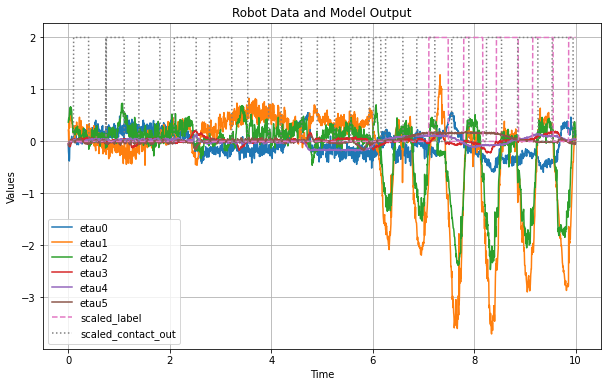

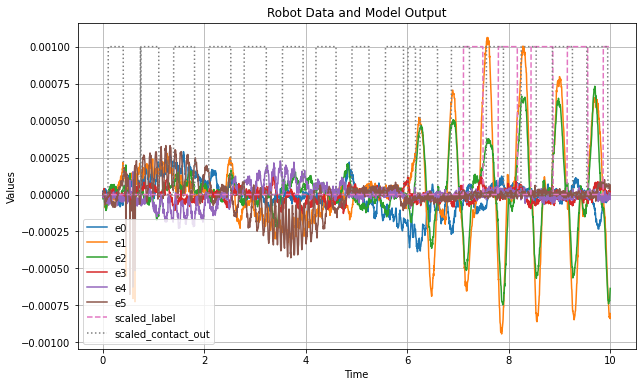

In [48]:
# Drop rows where 'time' is less than 5 or greater than 10 in data_source_robot.df
data_ur5.df.drop(data_ur5.df[(data_ur5.df.time < 0) | (data_ur5.df.time > 10)].index, inplace=True)

# Drop rows where 'time' is less than 5 or greater than 10 in model_out_source_robot
model_out_ur5.drop(model_out_ur5[(model_out_ur5.time < 0) | (model_out_ur5.time > 10)].index, inplace=True)

# Scale the labels
scale = 2
data_ur5.df['scaled_label'] = data_ur5.df['label'] * scale
model_out_ur5['scaled_contact_out']=model_out_ur5['contact_out'] * scale

# Plotting both datasets on the same plot
plt.figure(figsize=(10, 6))

# Plot scaled label and tau values from data_source_robot
for tau_column in data_ur5.etau:
    plt.plot(data_ur5.df['time'], data_ur5.df[tau_column], label=tau_column)
plt.plot(data_ur5.df['time'], data_ur5.df['scaled_label'], label='scaled_label', linestyle='--')

# Plot contact_out and label from model_out_source_robot
plt.plot(model_out_ur5['time'], model_out_ur5['scaled_contact_out'], label='scaled_contact_out', linestyle=':')


# Customize the plot
plt.xlabel('Time')
plt.ylabel('Values')
plt.title('Robot Data and Model Output')
plt.legend()
plt.grid(True)

# Show the plot
plt.show()

# Scale the labels
scale = 0.001
data_ur5.df['scaled_label'] = data_ur5.df['label'] * scale
model_out_ur5['scaled_contact_out']=model_out_ur5['contact_out'] * scale
# Plotting both datasets on the same plot
plt.figure(figsize=(10, 6))

# Plot scaled label and tau values from data_source_robot
for tau_column in data_ur5.e:
    plt.plot(data_ur5.df['time'], data_ur5.df[tau_column], label=tau_column)
plt.plot(data_ur5.df['time'], data_ur5.df['scaled_label'], label='scaled_label', linestyle='--')

# Plot contact_out and label from model_out_source_robot
plt.plot(model_out_ur5['time'], model_out_ur5['scaled_contact_out'], label='scaled_contact_out', linestyle=':')


# Customize the plot
plt.xlabel('Time')
plt.ylabel('Values')
plt.title('Robot Data and Model Output')
plt.legend()
plt.grid(True)

# Show the plot

In [49]:
import plotly.graph_objs as go
# Scale the labels
scale = 2
data_ur5.df['scaled_label'] = data_ur5.df['label'] * scale
model_out_ur5['scaled_contact_out']=model_out_ur5['contact_out'] * scale

# Create traces for the first dataset
traces = []
for column in data_ur5.etau:
    traces.append(go.Scatter(x=data_ur5.df['time'], y=data_ur5.df[column], mode='lines', name=column))

# Add the scaled_label trace
traces.append(go.Scatter(x=data_ur5.df['time'], y=data_ur5.df['scaled_label'], mode='lines', name='scaled_label'))

# Example: Add another plot from model_out_target_robot (e.g., 'scaled_contact_out')
traces.append(go.Scatter(x=model_out_ur5['time'], y=model_out_ur5['scaled_contact_out'], mode='lines', name='scaled_contact_out'))

# Create the layout
layout = go.Layout(
    title='Combined Plot',
    xaxis=dict(title='Time'),
    yaxis=dict(title='Values'),
    showlegend=True
)

# Create the figure and plot it
fig = go.Figure(data=traces, layout=layout)
fig.show()
